In [4]:
import pandas as pd
import numpy as np
import seaborn as sns
import sklearn

# Librosa (the mother of audio files)
import librosa
import librosa.display
import IPython.display as ipd
import warnings
warnings.filterwarnings('ignore')

import matplotlib.pyplot as plt

%matplotlib inline

## 1. Como se le hace feature engeenier a una canción

La ingeniería de una canción, se puede hacer, analizando a la misma canción (El tono y la onda), como tambien los meta datos, lugar de grabación, artista, disquera, duración, presupuesto y más cosas.

En esté caso vamos a crear nuestro clasificador y recomendador a partir de analizár la onda.

Este artículo va contener varias partes, la primera es la ingeniería de caracterisitcas, con la finalidad de usarlo en algoritmos clasicos de Machine learning. La segunda es la parte de clasificiación y la tercera es la parte de recomendación.

### Información de una canción

para esto vamos a usar la librería ```librosa```, para eso cargamos la canción

In [5]:
# La canción que vamos analizar es limahl - Never Ending Story
y, sr = librosa.load("../Data/music.mp3") # y es el audio y sr es la frecuencia de muestreo

print("Frecuencia de muestreo: ", sr)
print("Duración: ", y.size/sr, "segundos")
print("Número de muestras: ", y.size)
print("Número de canales: ", y.ndim)

Frecuencia de muestreo:  22050
Duración:  209.6587755102041 segundos
Número de muestras:  4622976
Número de canales:  1


In [6]:
# A ver que serie les recuerda esto
ipd.Audio(y, rate=sr)

Muchas de las canciones modernas, tienen un silencio al principio y al final.
Toca recortarlo

In [7]:
#  Recorta el silencio inicial y final
audio_file, _ = librosa.effects.trim(y)
ipd.Audio(audio_file, rate=sr)

Vemos que recorta dos segundos.

### Representación 2D

Con la librería liibrosa tambien podemos hacer una representación 2D de la canción.

Text(0.5, 1.0, 'Never Ending Story')

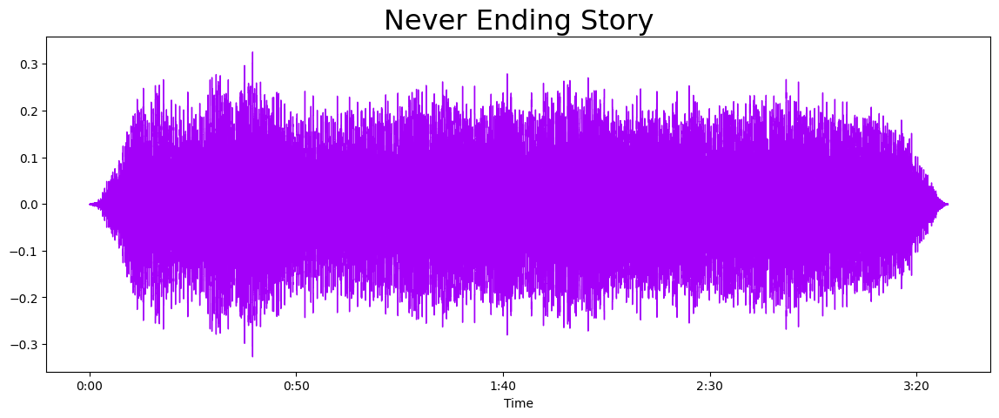

In [8]:
plt.figure(figsize=(14, 5))
librosa.display.waveshow(audio_file, sr=sr, color="#A300F9")
plt.title("Never Ending Story", fontsize = 23)

Aqui, se ve la representación de la canción, através del tiempo.

### Transformada de Fourier

Cuando se trabaja con señales, una de las funciones más utilizadas es la transformada de fourier, la idea es descomponer la onada (En este caso el audio) en ondas primarías. Una analogía muy usada es con los colores, un color se puede componer en patrón RGB o HSV

In [9]:
n_fft = 2048 # Tamaño de la ventana
hop_length = 512 # Desplazamiento entre ventanas
D = np.abs(librosa.stft(audio_file, n_fft = n_fft, hop_length = hop_length))
print("Tamaño del array D", D.shape)


Tamaño del array D (1025, 8940)


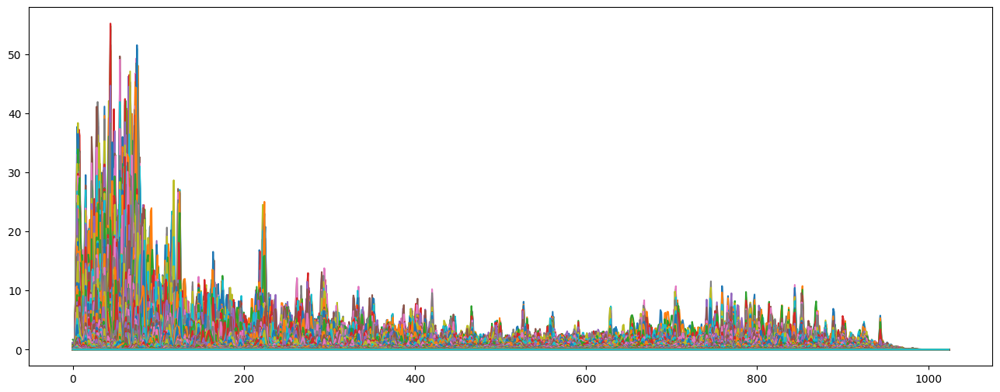

In [10]:
plt.figure(figsize = (16, 6))
plt.plot(D);

Aqui vemos como la onda se descompusó en las ondas primarias

### El espectograma

El espectograma es una representación visual del espectro de frecuencias de una señal que varia en el timepo.

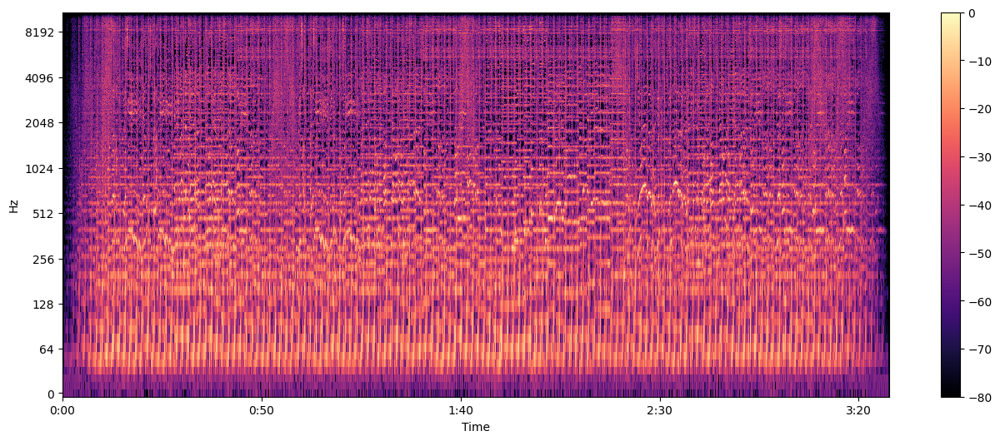

In [11]:
# Convertir a dB
DB = librosa.amplitude_to_db(D, ref = np.max)

# Creamos el espectrograma
plt.figure(figsize = (16, 6))
librosa.display.specshow(DB, sr = sr, hop_length = hop_length, x_axis = "time", y_axis = "log", cmap = "magma")

plt.colorbar()

### Mel espectograma

matemáticamente hablando, es el resultado de alguna transformación no lineal de la escala de frecuencias. El espectrograma Mel es un espectrograma normal, pero con una escala Mel en el eje y.

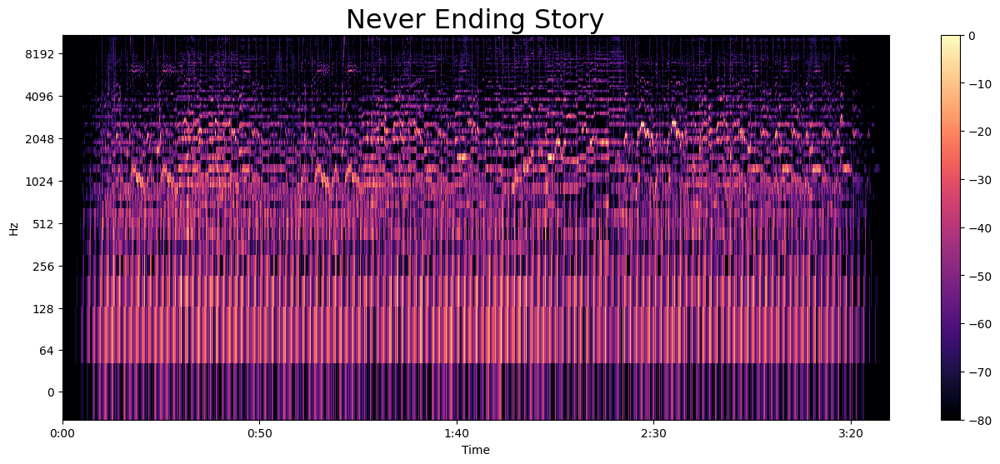

In [12]:
S = librosa.feature.melspectrogram(y, sr=sr)
S_DB = librosa.amplitude_to_db(S, ref=np.max)

plt.figure(figsize = (16, 6))
librosa.display.specshow(S_DB, sr = sr, hop_length = hop_length, x_axis = "time", y_axis = "log", cmap = "magma")
plt.colorbar()
plt.title("Never Ending Story", fontsize = 23);

### Características de los audios

#### Zero Crossing Rate

la velocidad a la que la señal cambia de positiva a negativa o viceversa.

In [13]:
# Total zero_crossings en una canción
zero_crossings = librosa.zero_crossings(audio_file, pad = False)
print(np.sum(zero_crossings))

756442


#### Harmonicos y perceptuales
* Los harmonicos, aquí un video de mis youtubers favoritos 
  [![Blinking LEDs](https://external-content.duckduckgo.com/iu/?u=https%3A%2F%2Festaticos.elperiodico.com%2Fresources%2Fjpg%2F3%2F4%2Fjaime-altozano-1527615456843.jpg&f=1&nofb=1&ipt=c6943e1402275abbdef24aa88c4ee833de462c8394ce35fed5a27d1078aada1b&ipo=images)](https://www.youtube.com/watch?v=xcHbm0vXFFE&t=0s "¿Qué es una Nota Musical? feat. Jaime Altozano")

* Comprensión perceptual la onda de choque representa el ritmo y la emoción del sonido

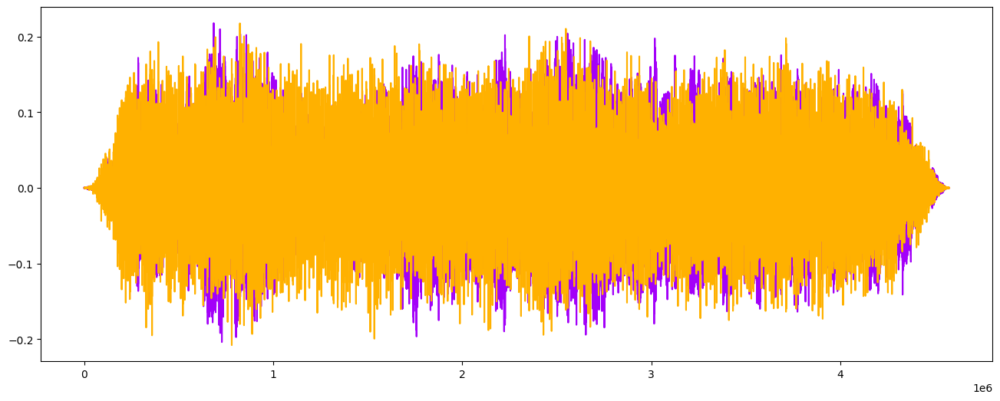

In [14]:
y_harm, y_perc = librosa.effects.hpss(audio_file)
plt.figure(figsize = (16, 6))
plt.plot(y_harm, color = '#A300F9')
plt.plot(y_perc, color = '#FFB100')

#### Tempo BMP( Beats por minuto)

In [15]:
tempo, _ = librosa.beat.beat_track(y = audio_file, sr = sr)
tempo

123.046875

#### Centroide espectral.
Indica el "centro de masa" para un sonido y es calculada con los pesos medios de la frecuencia

In [16]:
spectral_centroids = librosa.feature.spectral_centroid(y = audio_file, sr = sr)[0]

print("tamaño del array de centroides", spectral_centroids.shape)

# Computando el tiempo de cada frame
frames = range(len(spectral_centroids))

# Convertir de frames a segundos
t = librosa.frames_to_time(frames)

print("tamaño del array de tiempo", t.shape)

def normlize(x, axis = 0):
    return sklearn.preprocessing.minmax_scale(x, axis = axis)

tamaño del array de centroides (8940,)
tamaño del array de tiempo (8940,)


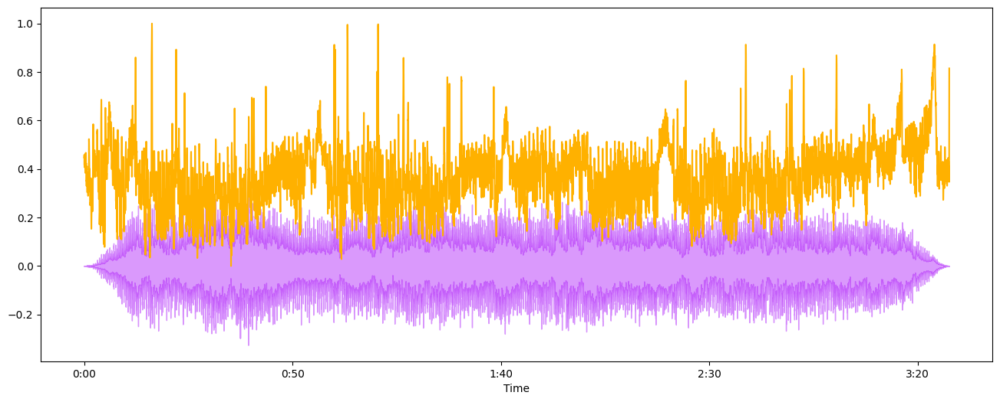

In [17]:
# Ploteamos el espectro de frecuencias en función del tiempo

plt.figure(figsize = (16, 6))
librosa.display.waveshow(audio_file, sr = sr, alpha = 0.4,  color = '#A300F9')

plt.plot(t, normlize(spectral_centroids), color = '#FFB100')


#### Spectral Rolloff
es una medida de la forma de la señal. Representa la frecuencia por debajo de la cual se encuentra un porcentaje determinado de la energía espectral total, por ejemplo, el 85%.

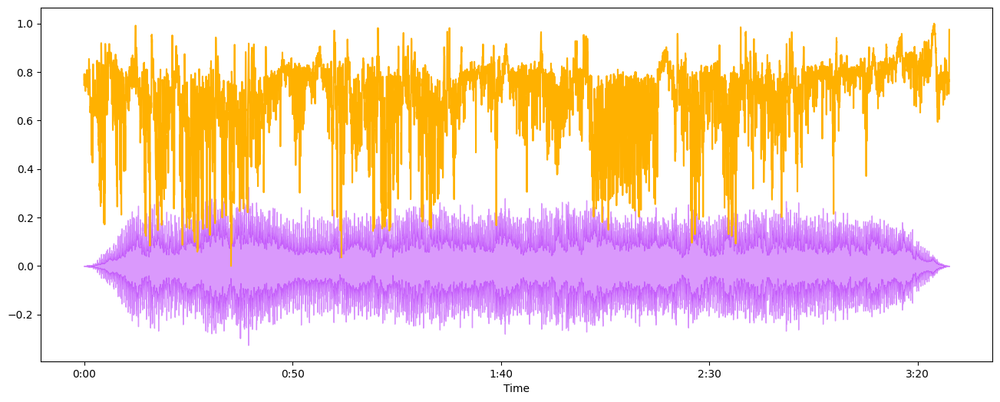

In [18]:
spectral_rolloff = librosa.feature.spectral_rolloff(y = audio_file, sr = sr)[0]

# Ploteamos el espectro de frecuencias en función del tiempo
plt.figure(figsize = (16, 6))
librosa.display.waveshow(audio_file, sr = sr, alpha = 0.4,  color = '#A300F9')
plt.plot(t, normlize(spectral_rolloff), color = '#FFB100')

### Coeficientes cepstrales de frecuencia Mel:

Los coeficientes cepstrales de frecuencias Mel (MFCC) de una señal son un pequeño conjunto de características (normalmente unas 10-20) que describen de forma concisa la forma general de una envolvente espectral. Modeliza las características de la voz humana.

Tamaño del array de MFCCs (13, 8940)


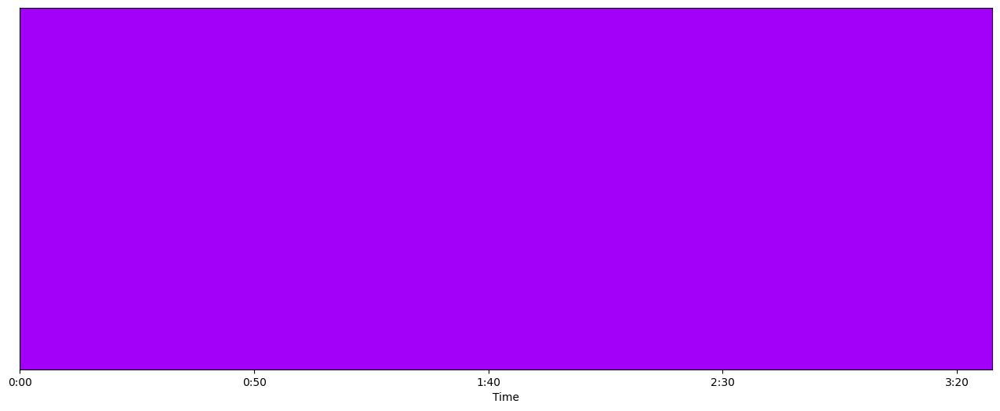

In [19]:
mfccs = librosa.feature.mfcc(y = audio_file, sr = sr, n_mfcc = 13)
print("Tamaño del array de MFCCs", mfccs.shape)

# Ploteamos el espectro de frecuencias en función del tiempo

# Escalamos

mfccs = sklearn.preprocessing.scale(mfccs, axis = 1)
plt.figure(figsize = (16, 6))
librosa.display.specshow(mfccs, sr = sr, color = '#A300F9', x_axis='time', cmap = 'cool')

### Chroma Frequencies

Las características cromáticas son una interesante y potente representación del audio musical en la que todo el espectro se proyecta en 12 bins que representan los 12 semitonos (o croma) distintos de la octava musical.

Chromogram shape: (12, 916)


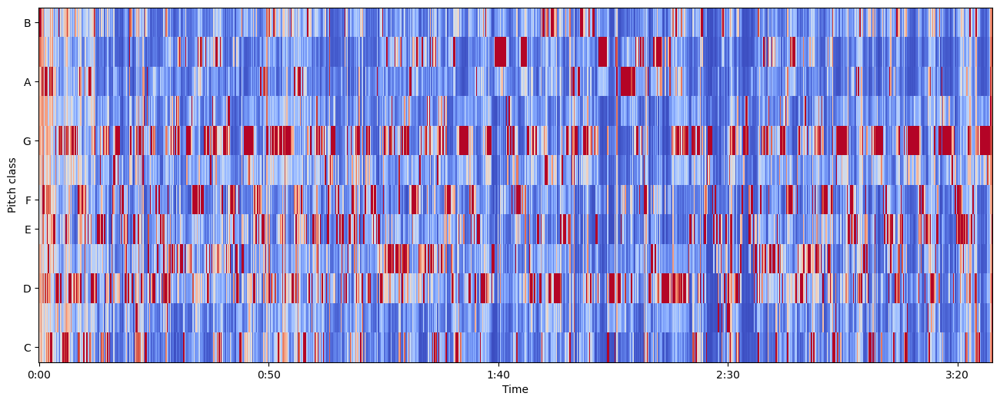

In [20]:
hop_length = 5000
chromagram = librosa.feature.chroma_stft(audio_file, sr=sr, hop_length=hop_length)
print('Chromogram shape:', chromagram.shape)

plt.figure(figsize=(16, 6))
librosa.display.specshow(chromagram, x_axis='time', y_axis='chroma', hop_length=hop_length, cmap='coolwarm');

## 2. Eda

Luego de saber de hacer la ingeniería de caracteristicas. Pasamos a convertir todo esta información, en datos estructurados, para eso a cada una de estas caracteristicas, sacamos la media y el desviación estandar.

In [21]:
# Aquivemos la estructura de los datos
df = pd.read_csv("../Data/features_3_sec.csv")
print(df.shape)
df.head()

(9990, 60)


,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.0.wav,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,blues.00000.1.wav,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,blues.00000.2.wav,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,blues.00000.3.wav,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,blues.00000.4.wav,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues


In [62]:
len(df.columns

Index(['filename', 'length', 'chroma_stft_mean', 'chroma_stft_var', 'rms_mean',
       'rms_var', 'spectral_centroid_mean', 'spectral_centroid_var',
       'spectral_bandwidth_mean', 'spectral_bandwidth_var', 'rolloff_mean',
       'rolloff_var', 'zero_crossing_rate_mean', 'zero_crossing_rate_var',
       'harmony_mean', 'harmony_var', 'perceptr_mean', 'perceptr_var', 'tempo',
       'mfcc1_mean', 'mfcc1_var', 'mfcc2_mean', 'mfcc2_var', 'mfcc3_mean',
       'mfcc3_var', 'mfcc4_mean', 'mfcc4_var', 'mfcc5_mean', 'mfcc5_var',
       'mfcc6_mean', 'mfcc6_var', 'mfcc7_mean', 'mfcc7_var', 'mfcc8_mean',
       'mfcc8_var', 'mfcc9_mean', 'mfcc9_var', 'mfcc10_mean', 'mfcc10_var',
       'mfcc11_mean', 'mfcc11_var', 'mfcc12_mean', 'mfcc12_var', 'mfcc13_mean',
       'mfcc13_var', 'mfcc14_mean', 'mfcc14_var', 'mfcc15_mean', 'mfcc15_var',
       'mfcc16_mean', 'mfcc16_var', 'mfcc17_mean', 'mfcc17_var', 'mfcc18_mean',
       'mfcc18_var', 'mfcc19_mean', 'mfcc19_var', 'mfcc20_mean', 'mfcc20_var',
  

In [22]:
# Miremos información de las columnas
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9990 entries, 0 to 9989
Data columns (total 60 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   filename                 9990 non-null   object 
 1   length                   9990 non-null   int64  
 2   chroma_stft_mean         9990 non-null   float64
 3   chroma_stft_var          9990 non-null   float64
 4   rms_mean                 9990 non-null   float64
 5   rms_var                  9990 non-null   float64
 6   spectral_centroid_mean   9990 non-null   float64
 7   spectral_centroid_var    9990 non-null   float64
 8   spectral_bandwidth_mean  9990 non-null   float64
 9   spectral_bandwidth_var   9990 non-null   float64
 10  rolloff_mean             9990 non-null   float64
 11  rolloff_var              9990 non-null   float64
 12  zero_crossing_rate_mean  9990 non-null   float64
 13  zero_crossing_rate_var   9990 non-null   float64
 14  harmony_mean            

In [23]:
# Hagamos un analisis estadistico
df.describe()

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
count,9990.0,9990.000000,9990.000000,9990.000000,9.990000e+03,9990.000000,9.990000e+03,9990.000000,9.990000e+03,9990.000000,...,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000,9990.000000
mean,66149.0,0.379534,0.084876,0.130859,2.676388e-03,2199.219431,4.166727e+05,2241.385959,1.182711e+05,4566.076592,...,1.448240,49.988755,-4.198706,51.962753,0.739943,52.488851,-2.497306,54.973829,-0.917584,57.322614
std,0.0,0.090466,0.009637,0.068545,3.585628e-03,751.860611,4.349644e+05,543.854449,1.013505e+05,1642.065335,...,5.735149,34.442816,5.677379,36.400669,5.181313,38.177120,5.111799,41.585677,5.253243,46.444212
min,66149.0,0.107108,0.015345,0.000953,4.379535e-08,472.741636,8.118813e+02,499.162910,1.183520e+03,658.336276,...,-26.850016,1.325786,-27.809795,1.624544,-20.733809,3.437439,-27.448456,3.065302,-35.640659,0.282131
25%,66149.0,0.315698,0.079833,0.083782,6.145900e-04,1630.680158,1.231961e+05,1887.455790,4.876553e+04,3378.311110,...,-2.227478,29.584894,-7.951722,29.863448,-2.516638,29.636197,-5.734123,30.496412,-4.004475,30.011365
50%,66149.0,0.384741,0.085108,0.121253,1.491318e-03,2208.628236,2.650692e+05,2230.575595,8.996072e+04,4631.377892,...,1.461623,41.702393,-4.443021,42.393583,0.733772,41.831377,-2.702366,43.435253,-1.030939,44.332155
75%,66149.0,0.442443,0.091092,0.176328,3.130862e-03,2712.581884,5.624152e+05,2588.340505,1.585674e+05,5591.634521,...,5.149752,59.274619,-0.726945,61.676964,3.888734,62.033906,0.514246,65.328602,2.216603,68.210421
max,66149.0,0.749481,0.120964,0.442567,3.261522e-02,5432.534406,4.794119e+06,3708.147554,1.235143e+06,9487.446477,...,39.144405,683.932556,34.048843,529.363342,36.970322,629.729797,31.365425,1143.230591,34.212101,910.473206


In [24]:
from sklearn.model_selection import train_test_split

# Separamos los datos en X y Y
Y = df["label"]
X = df.drop(["filename", "label"], axis = 1)

# Separamos los datos
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2, random_state = 42, stratify = Y)

# Extraemos las columnas que contienen la media y la varianza
mean_columns = X_train.filter(regex='mean').columns
var_columns = X_train.filter(regex='var').columns

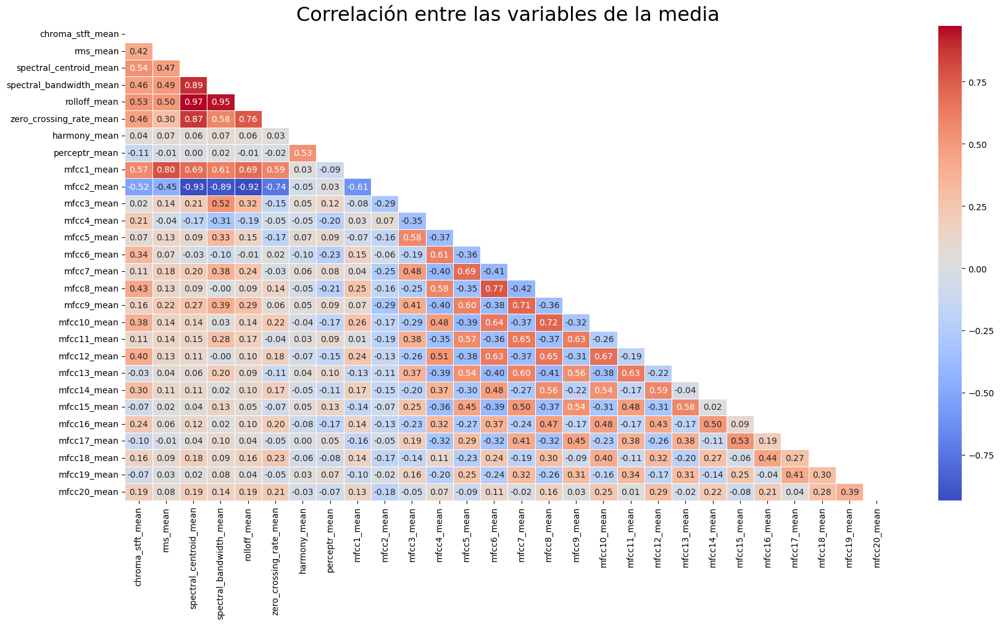

In [25]:
def plot_corr(corr, title):
    matrix = np.triu(corr)
    plt.figure(figsize = (20, 10))
    plt.title(title, fontsize = 23)
    sns.heatmap(corr, mask = matrix, cmap = "coolwarm", annot=True, fmt=".2f", linewidths=0.5)

corr_mean = X_train[mean_columns].corr()
plot_corr(corr_mean, "Correlación entre las variables de la media")

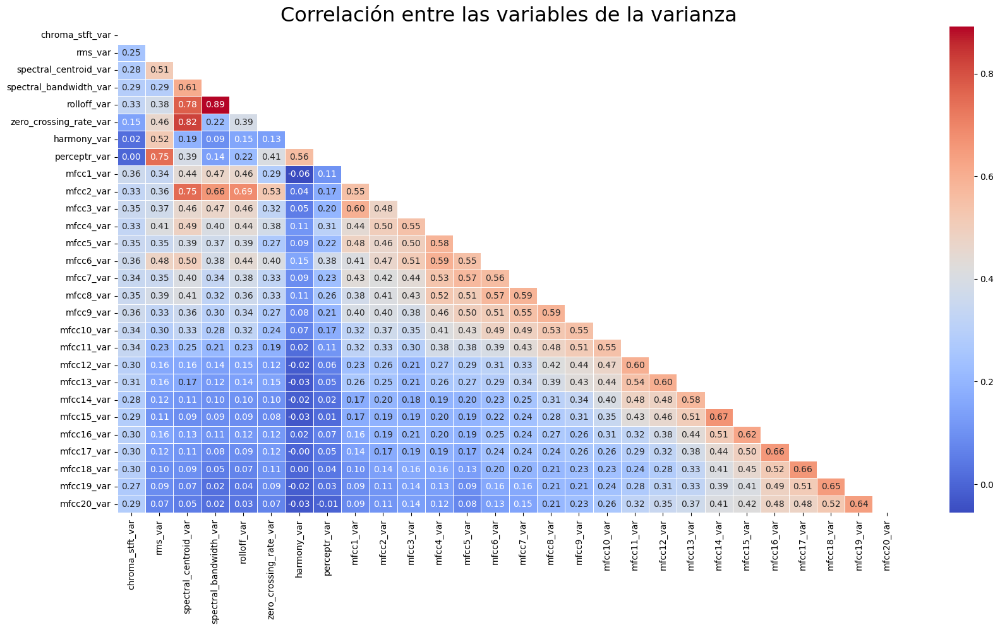

In [26]:
corr_var = X_train[var_columns].corr()
plot_corr(corr_var, "Correlación entre las variables de la varianza")

La correlación, tanto de las columnas que son de varianza y de las medias, muchos datos se correlaciona. Una buena técnica es dejar solo una varaible de los que se correlaciona.

Esta aleminación se podría hacer hablando con un experto para saber que varaibles son las más importantes o a coger expericia en el tema.

Algo que buscamos es iterar rápido en la creación del pipeline para recibir feedback, tanto del usuario interesado  y otros compañeros. Por eso algo rápido que nos puede ayudar es hacer un PCA

Es importante entender que por un lado tenemos las columnas con la media y la varianza.

El análisis de PCA lo vamos a dividir en dos, por un lado con la medía, y por otro con la varianza

<AxesSubplot: >

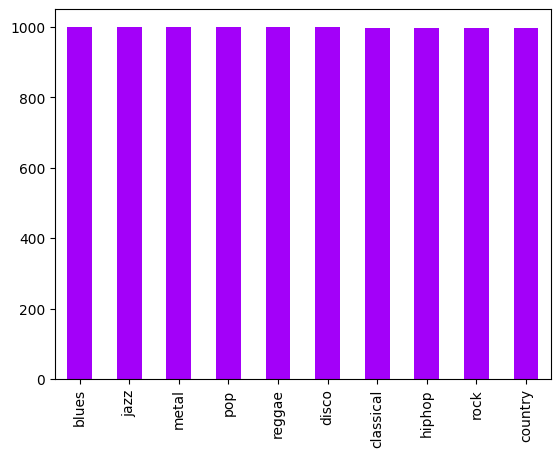

In [27]:
# Ploteamos label para ver la distribución
Y.value_counts().plot(kind = "bar", color = "#A300F9")

Los datos están balanceados, el accuracy nos sirve como métrica

In [28]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import make_pipeline
from sklearn.compose import  make_column_transformer

# Hacemos el pipeline para la media y la varianza
pipeline_mean = make_pipeline(StandardScaler(),  PCA(n_components=12))
pipeline_var = make_pipeline(StandardScaler(), PCA(n_components=7))

preposesing = make_column_transformer(
    (pipeline_mean, mean_columns), 
    (pipeline_var, var_columns)
    )
preposesing

ColumnTransformer(transformers=[('pipeline-1',
                                 Pipeline(steps=[('standardscaler',
                                                  StandardScaler()),
                                                 ('pca',
                                                  PCA(n_components=12))]),
                                 Index(['chroma_stft_mean', 'rms_mean', 'spectral_centroid_mean',
       'spectral_bandwidth_mean', 'rolloff_mean', 'zero_crossing_rate_mean',
       'harmony_mean', 'perceptr_mean', 'mfcc1_mean', 'mfcc2_mean',
       'mfcc3_mean', 'mfcc4_mean', 'mfcc5_me...
       'spectral_bandwidth_var', 'rolloff_var', 'zero_crossing_rate_var',
       'harmony_var', 'perceptr_var', 'mfcc1_var', 'mfcc2_var', 'mfcc3_var',
       'mfcc4_var', 'mfcc5_var', 'mfcc6_var', 'mfcc7_var', 'mfcc8_var',
       'mfcc9_var', 'mfcc10_var', 'mfcc11_var', 'mfcc12_var', 'mfcc13_var',
       'mfcc14_var', 'mfcc15_var', 'mfcc16_var', 'mfcc17_var', 'mfcc18_var',
       'mfcc19_var', 'mfcc20_var'],
      dtype='object'))])

In [29]:
# Transformamos los datos
preposesing.fit(X_train)
x_trasform =  preposesing.transform(X_train)
print(f"shape: {x_trasform.shape}")

shape: (7992, 19)


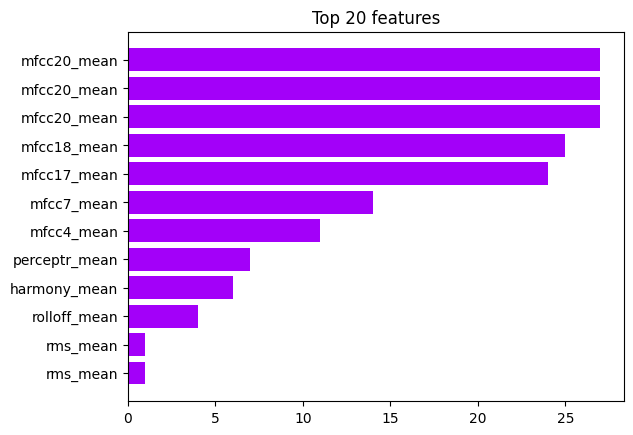

In [30]:

def plot_pca_imports(model, n_pcs, columns):

    most_importan_features = [np.abs(model.components_[i]).argmax() for i in range(n_pcs)]
    most_importan_name = [columns[i] for i in most_importan_features]

    zipped_feats = zip(most_importan_name, most_importan_features)
    zipped_feats = sorted(zipped_feats, key = lambda x: x[1], reverse = False)
    features, immportances = zip(*zipped_feats)
    top_features = features[:20]
    plt.title("Top 20 features")
    plt.barh(range(len(top_features)), immportances[:20], color = "#A300F9")
    plt.yticks(range(len(top_features)), top_features)
    plt.show()
    most_importan_name = [most_importan_name[x] + f"_PCA_{x}" for x in range(len(most_importan_name))]
    return most_importan_name

model = preposesing.transformers_[0][1].named_steps['pca']
n_pcs = model.components_.shape[0]
most_importan_name_mean = plot_pca_imports(model, n_pcs, list(mean_columns))

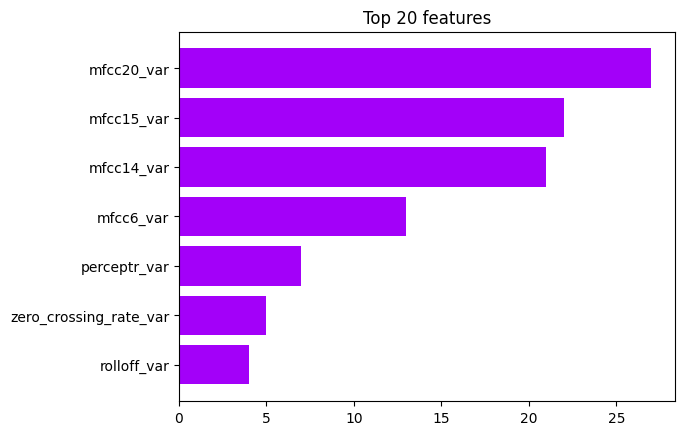

In [31]:
model = preposesing.transformers_[1][1].named_steps['pca']
n_pcs = model.components_.shape[0]
most_importan_name_var = plot_pca_imports(model, n_pcs, list(var_columns))

El número de componentes salieron, de mirar varias veces la gráfica, moviendole los componentes.

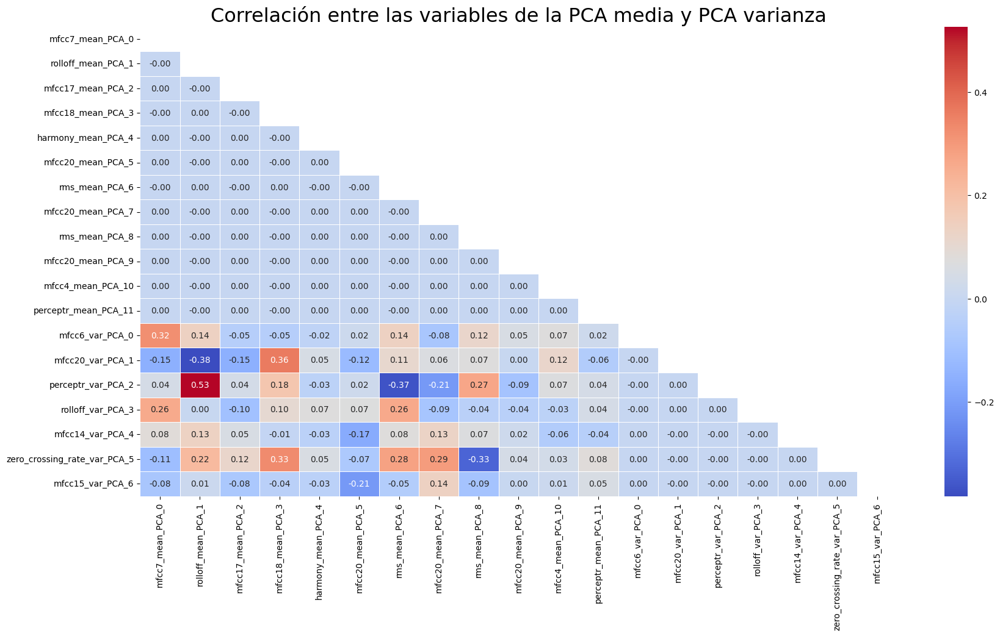

In [32]:
# Veamos la correlación entre las variables, de nuetros componentes
df_transform = pd.DataFrame(x_trasform, columns = most_importan_name_mean +most_importan_name_var)
corr = df_transform.corr()
plot_corr(corr, "Correlación entre las variables de la PCA media y PCA varianza")

df_transform["label"] = Y_train.values

In [33]:
df_transform.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7992 entries, 0 to 7991
Data columns (total 20 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   mfcc7_mean_PCA_0              7992 non-null   float64
 1   rolloff_mean_PCA_1            7992 non-null   float64
 2   mfcc17_mean_PCA_2             7992 non-null   float64
 3   mfcc18_mean_PCA_3             7992 non-null   float64
 4   harmony_mean_PCA_4            7992 non-null   float64
 5   mfcc20_mean_PCA_5             7992 non-null   float64
 6   rms_mean_PCA_6                7992 non-null   float64
 7   mfcc20_mean_PCA_7             7992 non-null   float64
 8   rms_mean_PCA_8                7992 non-null   float64
 9   mfcc20_mean_PCA_9             7992 non-null   float64
 10  mfcc4_mean_PCA_10             7992 non-null   float64
 11  perceptr_mean_PCA_11          7992 non-null   float64
 12  mfcc6_var_PCA_0               7992 non-null   float64
 13  mfc

array([[<AxesSubplot: title={'center': 'mfcc7_mean_PCA_0'}>,
        <AxesSubplot: title={'center': 'rolloff_mean_PCA_1'}>,
        <AxesSubplot: title={'center': 'mfcc17_mean_PCA_2'}>,
        <AxesSubplot: title={'center': 'mfcc18_mean_PCA_3'}>],
       [<AxesSubplot: title={'center': 'harmony_mean_PCA_4'}>,
        <AxesSubplot: title={'center': 'mfcc20_mean_PCA_5'}>,
        <AxesSubplot: title={'center': 'rms_mean_PCA_6'}>,
        <AxesSubplot: title={'center': 'mfcc20_mean_PCA_7'}>],
       [<AxesSubplot: title={'center': 'rms_mean_PCA_8'}>,
        <AxesSubplot: title={'center': 'mfcc20_mean_PCA_9'}>,
        <AxesSubplot: title={'center': 'mfcc4_mean_PCA_10'}>,
        <AxesSubplot: title={'center': 'perceptr_mean_PCA_11'}>],
       [<AxesSubplot: title={'center': 'mfcc6_var_PCA_0'}>,
        <AxesSubplot: title={'center': 'mfcc20_var_PCA_1'}>,
        <AxesSubplot: title={'center': 'perceptr_var_PCA_2'}>,
        <AxesSubplot: title={'center': 'rolloff_var_PCA_3'}>],
       [

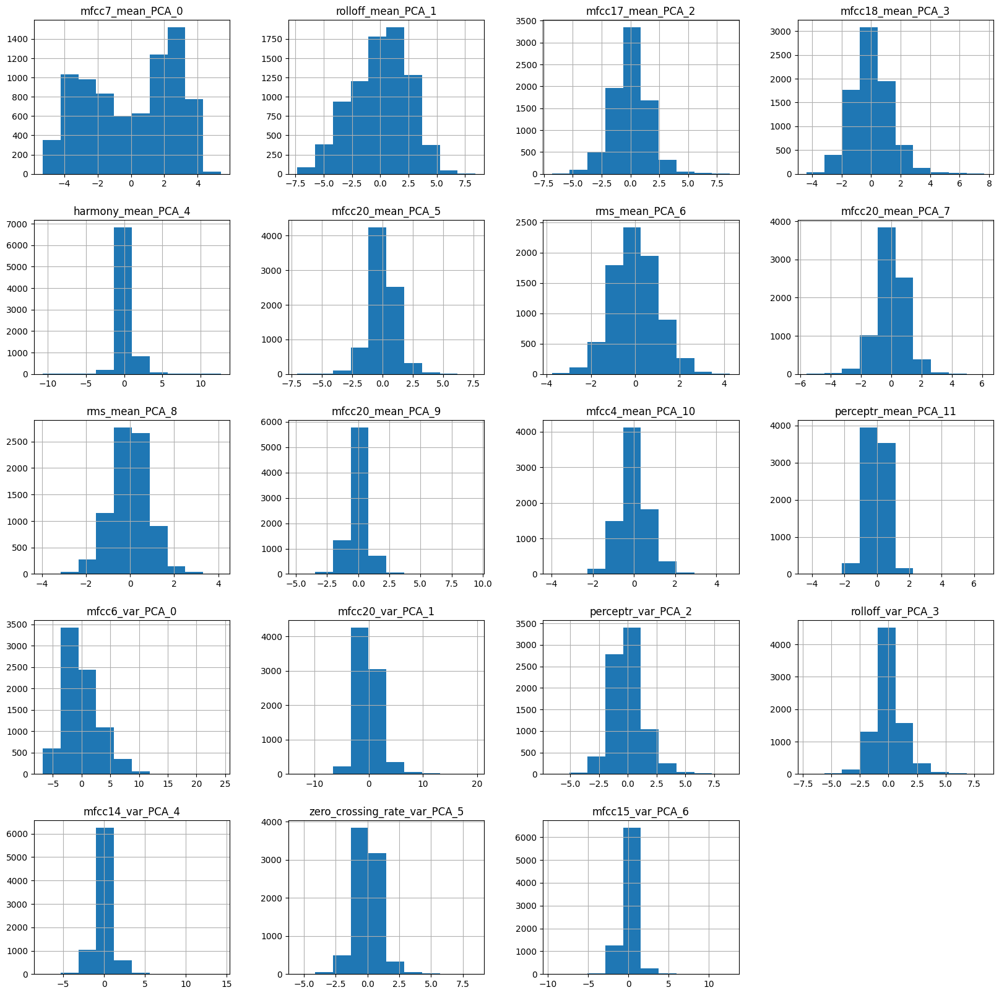

In [34]:
df_transform.hist(figsize = (20, 20))

Al ver la distribución, los que tienen mayor varianza son _mean_PCA_0 y el _var_PCA_0 dado que gracias al PCA son las dos variables con mayor varainza

## Modelado

### Clasificación

In [35]:
from sklearn.linear_model import SGDClassifier, LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier, XGBRFClassifier
from xgboost import plot_tree, plot_importance
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, roc_curve
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import RFE


In [36]:
def model_assess(model, X_train, X_test, Y_train, Y_test, title = "Default"):
    model.fit(X_train, Y_train)
    
    preds = model.predict(X_train)
    print("Entrainamiento")
    print('Accuracy', title, ':', round(accuracy_score(Y_train, preds), 5), '\n')
    sns.heatmap(confusion_matrix(Y_train, preds), annot=True, fmt="d", )
    plt.show()
    
    print("Testeo")
    preds = model.predict(X_test)
    print('Accuracy', title, ':', round(accuracy_score(Y_test, preds), 5), '\n')
    sns.heatmap(confusion_matrix(Y_test, preds), annot=True, fmt="d")
    plt.show()
    

In [37]:
from sklearn.preprocessing import LabelEncoder
Y_train = LabelEncoder().fit_transform(Y_train.values.reshape(-1, 1))
Y_test = LabelEncoder().fit_transform(Y_test.values.reshape(-1, 1))

In [38]:
x_trasform_train = preposesing.transform(X_train)
x_transform_test = preposesing.transform(X_test)

Entrainamiento
Accuracy Stochastic Gradient Descent with PCA : 0.5284 



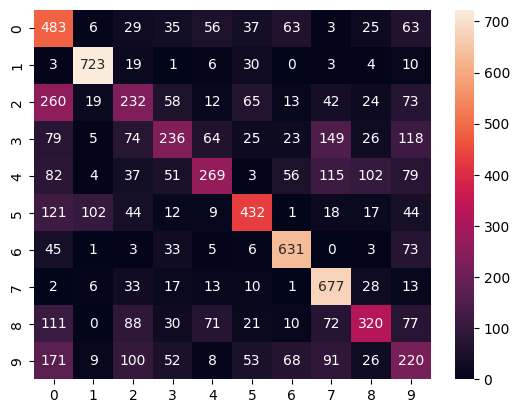

Testeo
Accuracy Stochastic Gradient Descent with PCA : 0.52503 



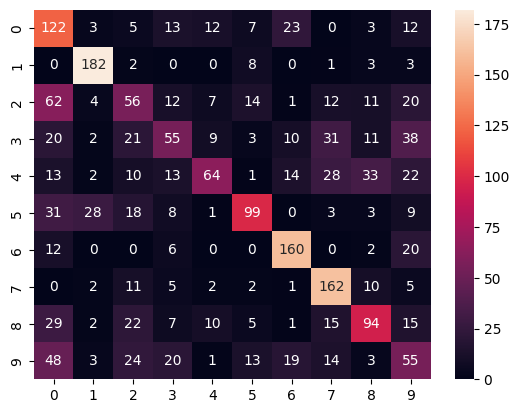

In [39]:
sgd = SGDClassifier(max_iter=5000, random_state=0)
model_assess(sgd,x_trasform_train, x_transform_test, Y_train, Y_test, "Stochastic Gradient Descent with PCA")

Entrainamiento
Accuracy Random Forest PCA : 0.91216 



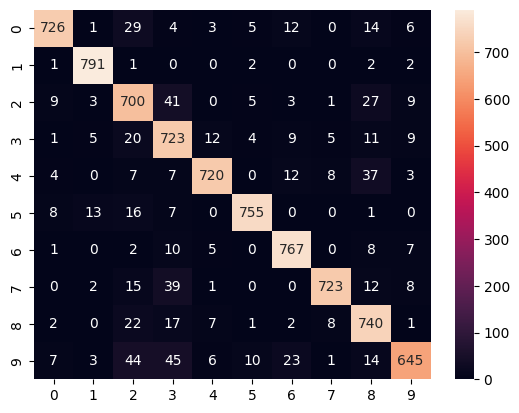

Testeo
Accuracy Random Forest PCA : 0.73373 



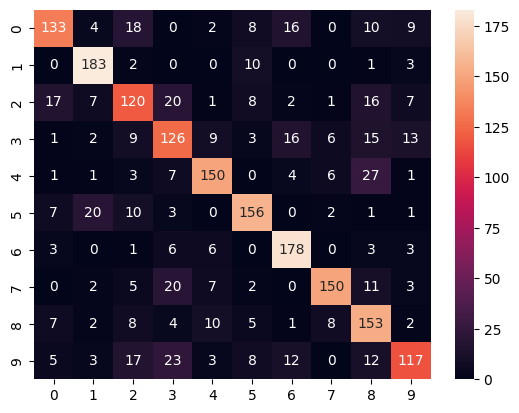

In [40]:
rforest = RandomForestClassifier(n_estimators=1000, max_depth=10, random_state=0)
model_assess(rforest,x_trasform_train, x_transform_test, Y_train, Y_test, "Random Forest PCA")

Entrainamiento
Accuracy KNN PCA : 0.81406 



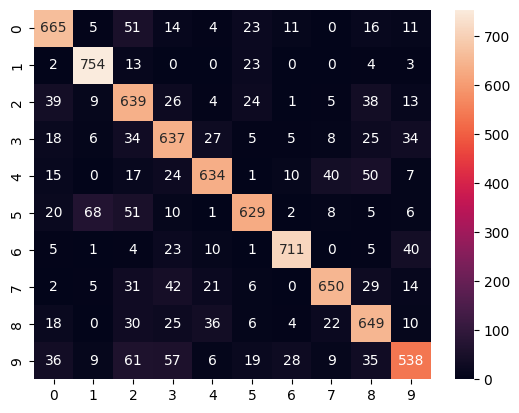

Testeo
Accuracy KNN PCA : 0.77678 



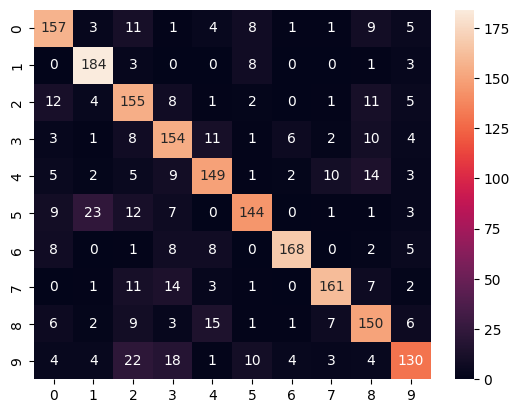

In [41]:
knn = KNeighborsClassifier(n_neighbors=19)
model_assess(knn,x_trasform_train, x_transform_test, Y_train, Y_test, "KNN PCA")

Entrainamiento
Accuracy Decission trees PCA : 0.999 



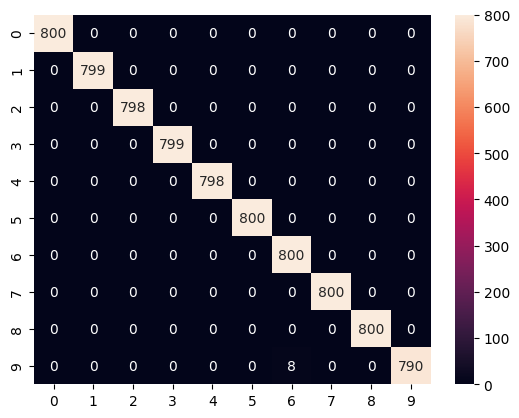

Testeo
Accuracy Decission trees PCA : 0.62062 



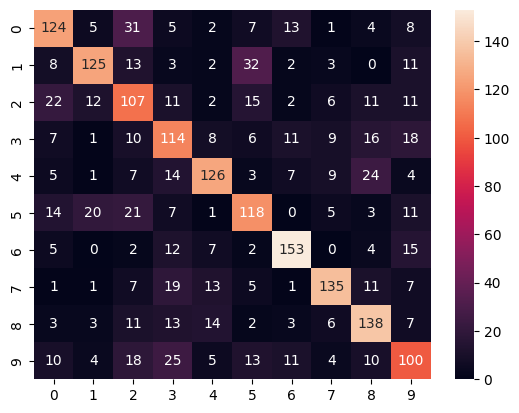

In [42]:
tree = DecisionTreeClassifier()
model_assess(tree,x_trasform_train, x_transform_test, Y_train, Y_test, "Decission trees PCA")

Entrainamiento
Accuracy Support Vector Machine PCA : 0.8232 



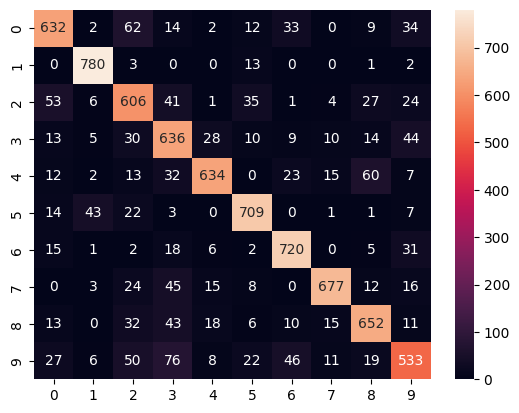

Testeo
Accuracy Support Vector Machine PCA : 0.77127 



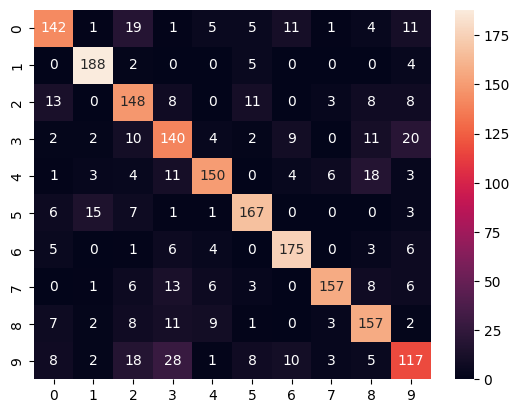

In [43]:
svm = SVC(decision_function_shape="ovo")
model_assess(svm, x_trasform_train, x_transform_test, Y_train, Y_test, "Support Vector Machine PCA")

Entrainamiento
Accuracy Cross Gradient Booster, PCA : 0.999 



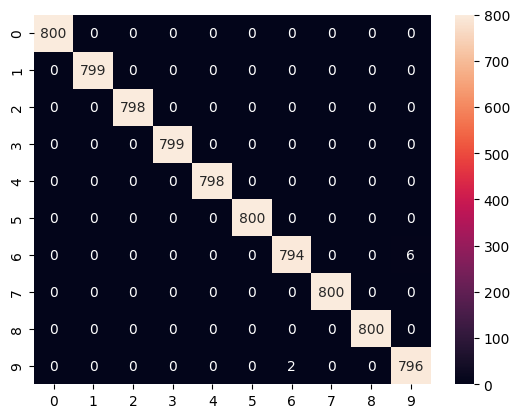

Testeo
Accuracy Cross Gradient Booster, PCA : 0.83383 



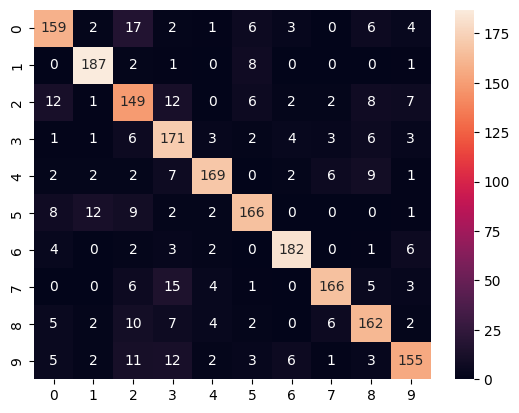

In [44]:
xgb = XGBClassifier(n_estimators=1000, learning_rate=0.05,tree_method="gpu_hist")
model_assess(xgb, x_trasform_train, x_transform_test,  Y_train, Y_test,"Cross Gradient Booster, PCA")

Entrainamiento
Accuracy Cross Gradient Booster (Random Forest) PCA : 0.77765 



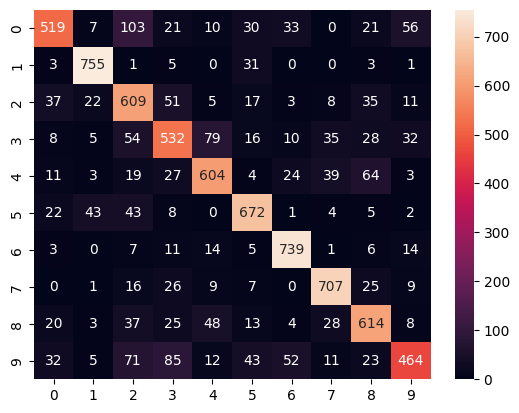

Testeo
Accuracy Cross Gradient Booster (Random Forest) PCA : 0.65916 



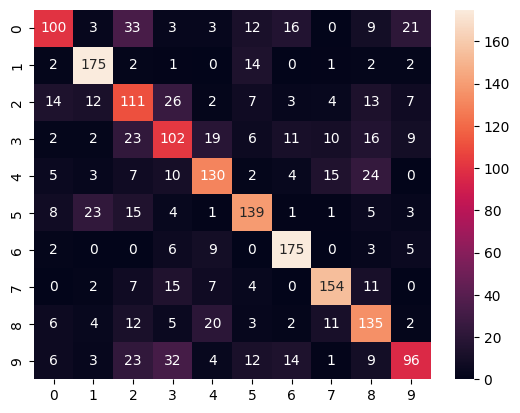

In [45]:
xgbrf = XGBRFClassifier(objective= 'multi:softmax', tree_method="gpu_hist")
model_assess(xgbrf, x_trasform_train, x_transform_test, Y_train, Y_test, "Cross Gradient Booster (Random Forest) PCA")

Entrainamiento
Accuracy LightGBM PCA : 0.999 



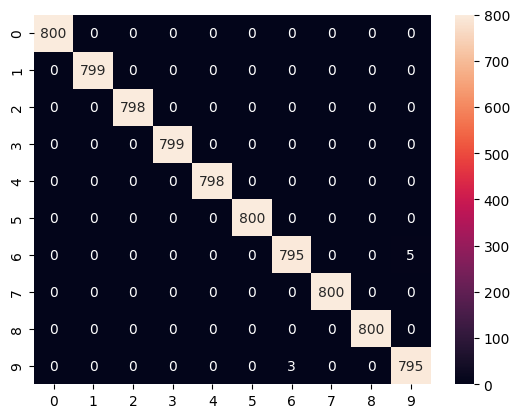

Testeo
Accuracy LightGBM PCA : 0.82933 



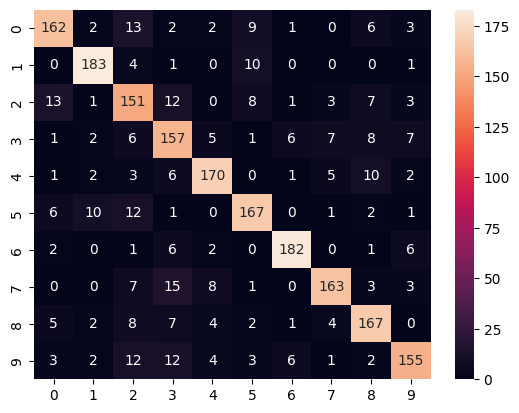

In [46]:
lgb = LGBMClassifier(n_jobs=-1 )
model_assess(lgb, x_trasform_train, x_transform_test, Y_train, Y_test, "LightGBM PCA")

### Sin aplicar PCA

In [47]:
pipeline_std = make_pipeline(StandardScaler())
X_train_std = pipeline_std.fit_transform(X_train)
X_test_std = pipeline_std.transform(X_test)

Entrainamiento
Accuracy Stochastic Gradient Descent : 0.69369 



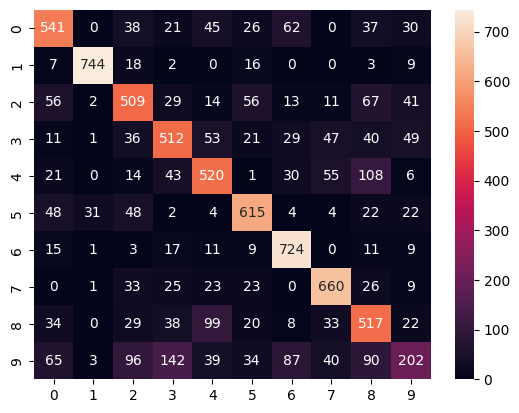

Testeo
Accuracy Stochastic Gradient Descent : 0.66867 



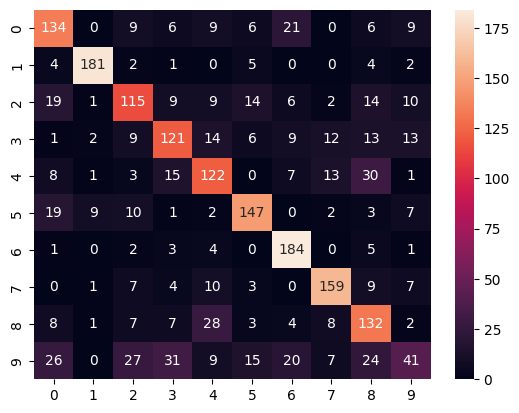

In [48]:
sgd = SGDClassifier(max_iter=5000, random_state=0)
model_assess(sgd, X_train_std, X_test_std, Y_train, Y_test, "Stochastic Gradient Descent")

Entrainamiento
Accuracy Random Forest : 0.96159 



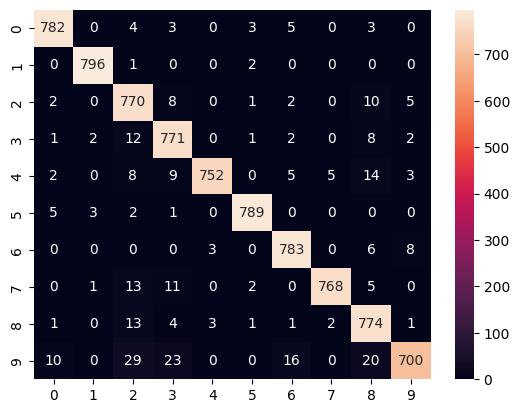

Testeo
Accuracy Random Forest : 0.79379 



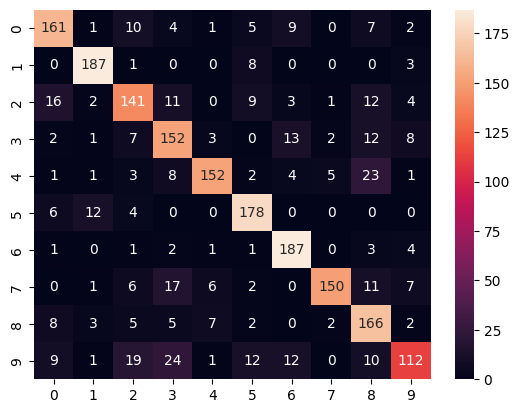

In [49]:
rforest = RandomForestClassifier(n_estimators=1000, max_depth=10, random_state=0)
model_assess(rforest, X_train_std, X_test_std, Y_train, Y_test, "Random Forest")


Entrainamiento
Accuracy KNN : 0.85523 



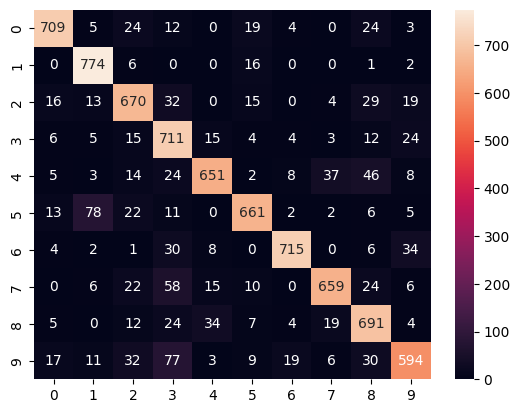

Testeo
Accuracy KNN : 0.8043 



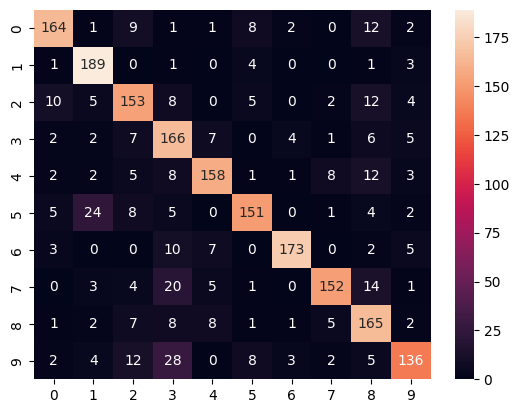

In [50]:
knn = KNeighborsClassifier(n_neighbors=19)
model_assess(knn, X_train_std, X_test_std, Y_train, Y_test, "KNN")

Entrainamiento
Accuracy Decission trees : 0.999 



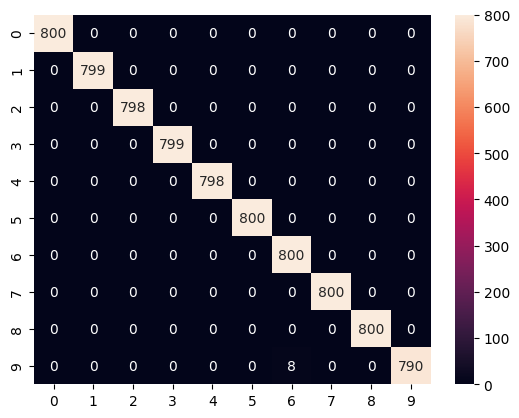

Testeo
Accuracy Decission trees : 0.63514 



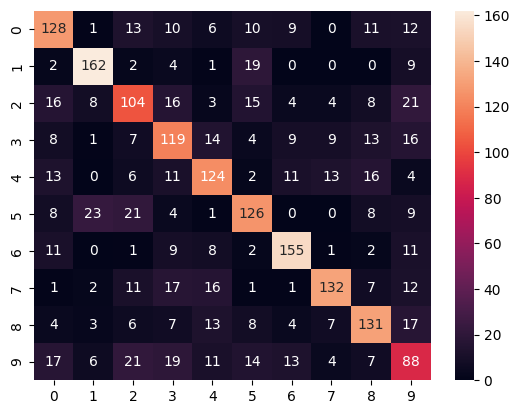

In [51]:
tree = DecisionTreeClassifier()
model_assess(tree,X_train_std, X_test_std, Y_train, Y_test, "Decission trees")

Entrainamiento
Accuracy Support Vector Machine : 0.9243 



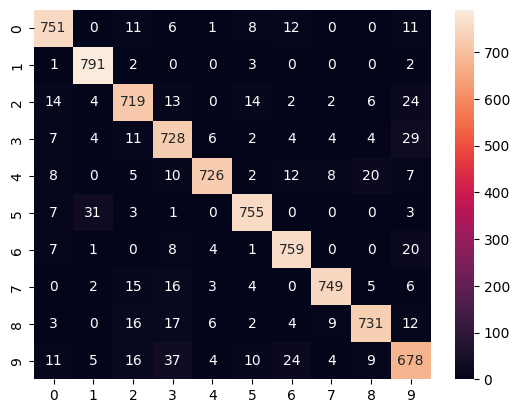

Testeo
Accuracy Support Vector Machine : 0.84585 



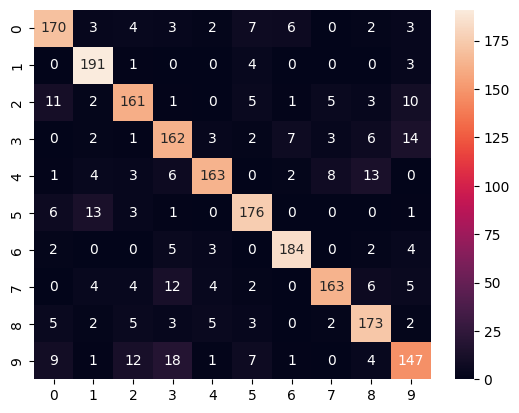

In [52]:
svm = SVC(decision_function_shape="ovo")
model_assess(svm, X_train_std, X_test_std, Y_train, Y_test, "Support Vector Machine")

Entrainamiento
Accuracy Cross Gradient Booster : 0.999 



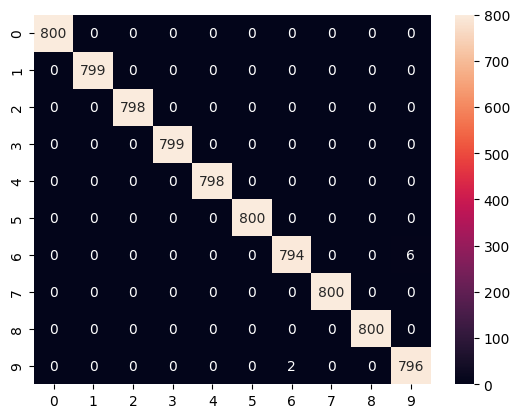

Testeo
Accuracy Cross Gradient Booster : 0.9029 



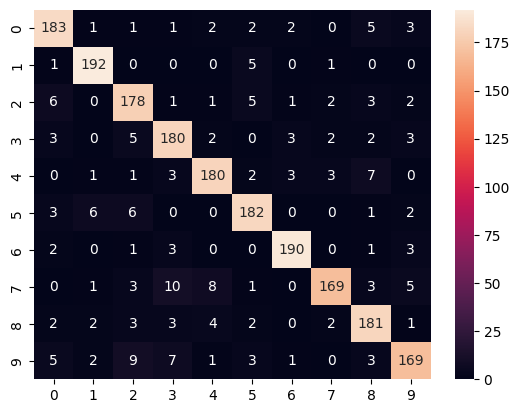

In [53]:
xgb = XGBClassifier(n_estimators=1000, learning_rate=0.05,tree_method="gpu_hist")
model_assess(xgb, X_train_std, X_test_std, Y_train, Y_test,"Cross Gradient Booster")

Entrainamiento
Accuracy Cross Gradient Booster (Random Forest) : 0.84635 



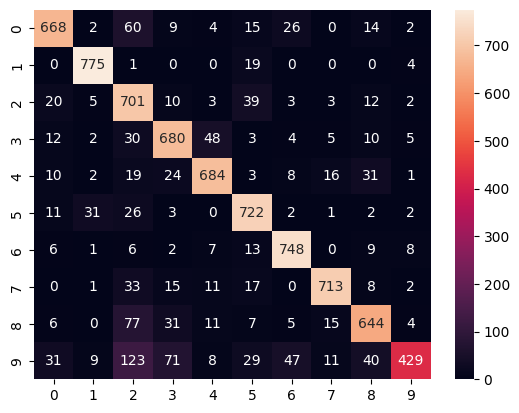

Testeo
Accuracy Cross Gradient Booster (Random Forest) : 0.73924 



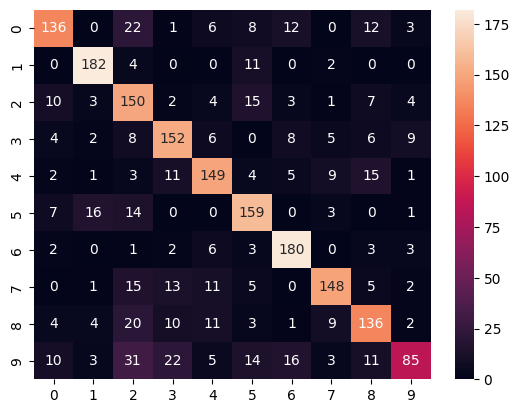

In [54]:
xgbrf = XGBRFClassifier(objective= 'multi:softmax', tree_method="gpu_hist")
model_assess(xgbrf,X_train_std, X_test_std, Y_train, Y_test, "Cross Gradient Booster (Random Forest)")

Entrainamiento
Accuracy LightGBM  : 0.999 



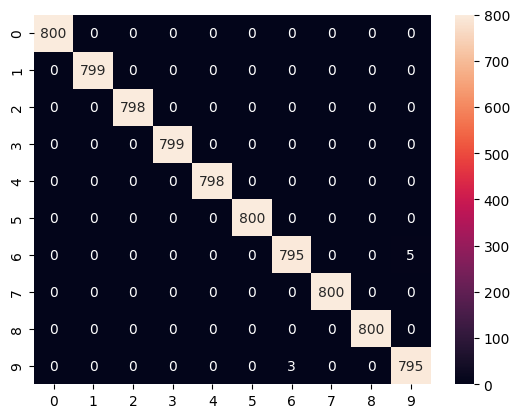

Testeo
Accuracy LightGBM  : 0.9029 



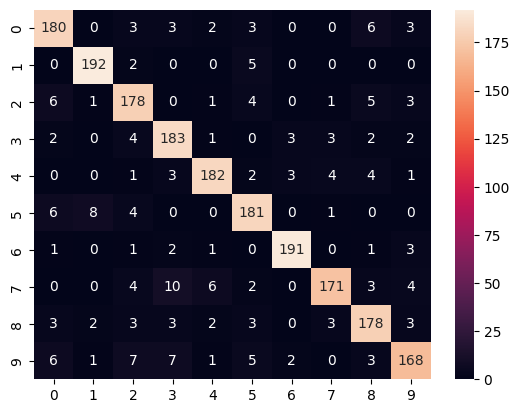

In [55]:
from lightgbm import LGBMClassifier
lgb = LGBMClassifier(n_jobs=-1 )
model_assess(lgb, X_train_std, X_test_std, Y_train, Y_test, "LightGBM ")

Learning rate set to 0.087975
0:	learn: 2.1693955	total: 93.4ms	remaining: 1m 33s
1:	learn: 2.0665251	total: 140ms	remaining: 1m 9s
2:	learn: 1.9852957	total: 183ms	remaining: 1m
3:	learn: 1.9039521	total: 226ms	remaining: 56.2s
4:	learn: 1.8347598	total: 268ms	remaining: 53.3s
5:	learn: 1.7710062	total: 309ms	remaining: 51.2s
6:	learn: 1.7124952	total: 351ms	remaining: 49.8s
7:	learn: 1.6596482	total: 393ms	remaining: 48.7s
8:	learn: 1.6065560	total: 434ms	remaining: 47.8s
9:	learn: 1.5677788	total: 475ms	remaining: 47.1s
10:	learn: 1.5250390	total: 520ms	remaining: 46.8s
11:	learn: 1.4852080	total: 562ms	remaining: 46.3s
12:	learn: 1.4579812	total: 607ms	remaining: 46.1s
13:	learn: 1.4235891	total: 649ms	remaining: 45.7s
14:	learn: 1.3954658	total: 692ms	remaining: 45.5s
15:	learn: 1.3702740	total: 735ms	remaining: 45.2s
16:	learn: 1.3460888	total: 779ms	remaining: 45s
17:	learn: 1.3179524	total: 821ms	remaining: 44.8s
18:	learn: 1.2974714	total: 866ms	remaining: 44.7s
19:	learn: 1.2

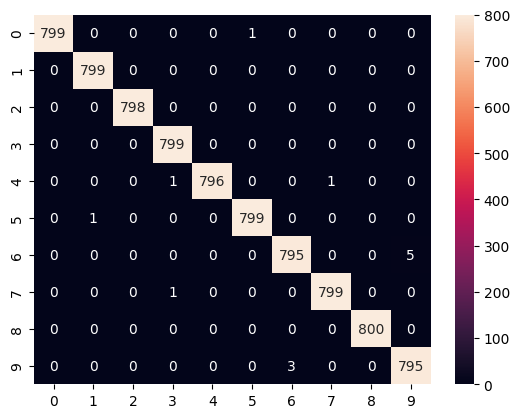

Testeo
Accuracy CatBoost : 0.9039 



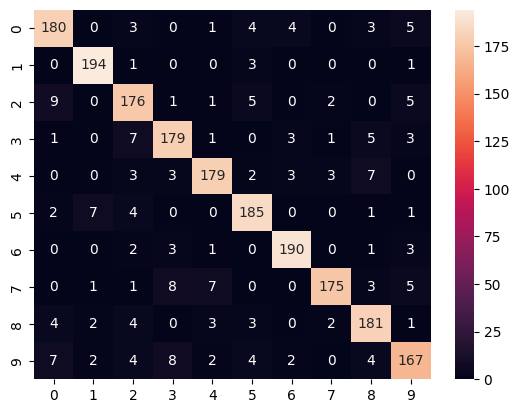

In [56]:
cat =  CatBoostClassifier()
model_assess(cat, X_train_std, X_test_std, Y_train, Y_test, "CatBoost")


Learning rate set to 0.087975
0:	learn: 2.1693955	total: 44.3ms	remaining: 44.2s
1:	learn: 2.0665251	total: 85.2ms	remaining: 42.5s
2:	learn: 1.9852957	total: 126ms	remaining: 41.7s
3:	learn: 1.9039521	total: 164ms	remaining: 40.9s
4:	learn: 1.8347598	total: 204ms	remaining: 40.6s
5:	learn: 1.7710062	total: 243ms	remaining: 40.2s
6:	learn: 1.7124952	total: 284ms	remaining: 40.3s
7:	learn: 1.6596482	total: 324ms	remaining: 40.2s
8:	learn: 1.6065560	total: 366ms	remaining: 40.3s
9:	learn: 1.5677788	total: 406ms	remaining: 40.2s
10:	learn: 1.5250390	total: 447ms	remaining: 40.2s
11:	learn: 1.4852080	total: 487ms	remaining: 40.1s
12:	learn: 1.4579812	total: 528ms	remaining: 40s
13:	learn: 1.4235891	total: 570ms	remaining: 40.1s
14:	learn: 1.3954658	total: 612ms	remaining: 40.2s
15:	learn: 1.3702740	total: 652ms	remaining: 40.1s
16:	learn: 1.3460888	total: 691ms	remaining: 39.9s
17:	learn: 1.3179524	total: 731ms	remaining: 39.9s
18:	learn: 1.2974714	total: 774ms	remaining: 40s
19:	learn: 1.

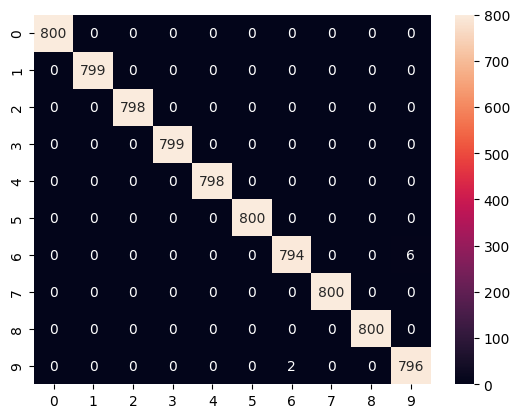

Testeo
Accuracy Ensemble : 0.91191 



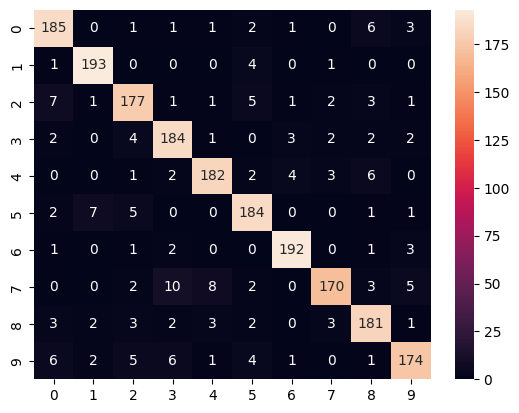

In [57]:
from sklearn.ensemble import VotingClassifier

elcf = VotingClassifier(
    estimators=[('xgb', xgb), ('lgb', lgb), ('cat', cat)], voting='soft', weights=[1,1,1])
model_assess(elcf, X_train_std, X_test_std, Y_train, Y_test, "Ensemble")

In [ ]:
from sklearn.metrics import classification_report
predict = xgb.predict(X_test)
repot = classification_report(Y_test, predict)
print(repot)

              precision    recall  f1-score   support

           0       0.46      0.21      0.29       200
           1       0.00      0.00      0.00       199
           2       0.00      0.00      0.00       199
           3       0.00      0.00      0.00       200
           4       0.10      0.69      0.18       200
           5       0.00      0.00      0.00       200
           6       0.00      0.00      0.00       200
           7       0.46      0.64      0.54       200
           8       0.24      0.30      0.26       200
           9       0.00      0.00      0.00       200

    accuracy                           0.18      1998
   macro avg       0.13      0.18      0.13      1998
weighted avg       0.13      0.18      0.13      1998



In [ ]:
featue_import = X_train.copy(deep=True)
featue_import["label"] = Y_train

  0%|          | 0/58 [00:00<?, ?it/s]

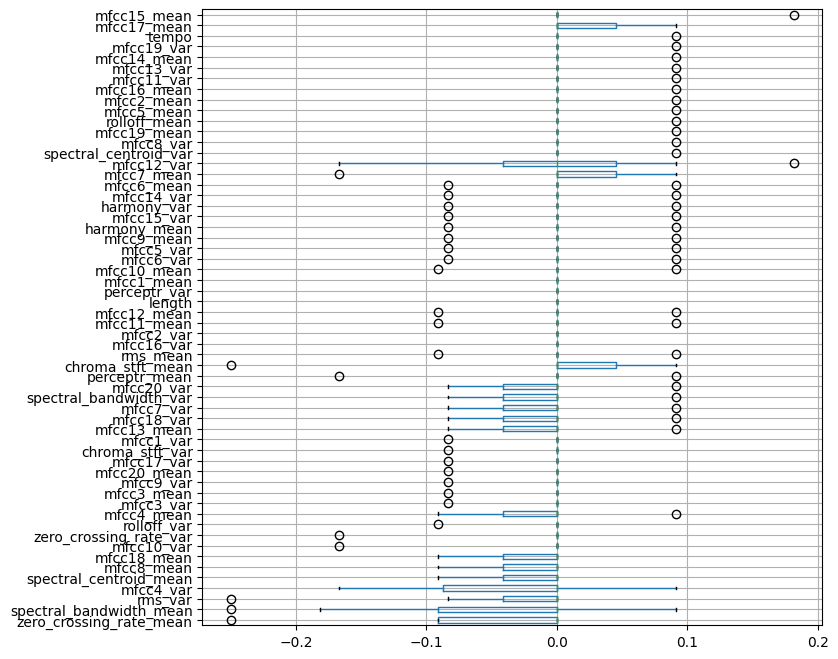

In [ ]:
"""
from sklearn.model_selection import KFold
from lofo import LOFOImportance, Dataset, plot_importance

def get_lofo_importance(df, target):
    cv = KFold(n_splits=7, shuffle=True, random_state=17)
    features = [col for col in df.columns if col != target]
    dataset = Dataset(df=df[df[target].notnull()], target=target, features=features)

    model = XGBClassifier(n_estimators=1000, learning_rate=0.05,tree_method="gpu_hist")
    lofo_imp = LOFOImportance(dataset, cv=cv, scoring="accuracy", model=model)

    return lofo_imp.get_importance()

sample_df = featue_import.sample(frac=0.01, random_state=0) 
plot_importance(get_lofo_importance(sample_df, target="label"), figsize=(8, 8), kind="box")
"""

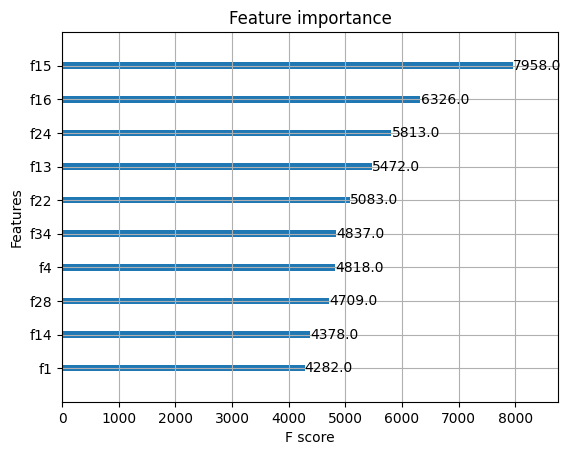

In [ ]:
from xgboost import plot_importance as plot_importance_xgb

plot_importance_xgb(xgb, max_num_features=10)
plt.show()